# Set-up & Helper Functions

In [1]:
import os
import gym
import slimevolleygym
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.style.use('seaborn')

from stable_baselines.ppo1 import PPO1
from stable_baselines import TRPO
from stable_baselines.common.policies import MlpPolicy
from stable_baselines import logger
from stable_baselines.common.callbacks import EvalCallback
from stable_baselines.bench import Monitor

from model import BnnPolicy

import gym
import slimevolleygym
from tqdm import tqdm

def evaluate(p1, p2, n=100):
    env = gym.make("SlimeVolley-v0")
    p1_scores=[]
    p2_scores=[]
    
    for i in tqdm(range(n)):
        obs1 = env.reset()
        obs2 = obs1 # both sides always see the same initial observation.

        done = False
        total_reward = 0

        while not done:

            action1, _ = p1.predict(obs1)
            action2, _ = p2.predict(obs2)

            obs1, reward, done, info = env.step(action1, action2) # extra argument
            obs2 = info['otherObs']

            total_reward += reward
            # env.render()
        p1_scores.append(total_reward)
        p2_scores.append(-total_reward)
        
    p1_score = np.mean(p1_scores)
    p2_score = np.mean(p2_scores)
    
    p1_var = np.std(p1_scores)
    p2_var = np.std(p2_scores)
    
    print(f"Player 1: {p1_score} +- {p1_var:.3f}")
    print(f"Player 2: {p2_score} +- {p2_var:.3f}")
        
    return p1_score, p2_score, p1_var, p2_var

def evaluate_single(p1, n=100):
    env = gym.make("SlimeVolley-v0")
    p1_scores=[]
    
    for i in tqdm(range(n)):
        obs1 = env.reset()

        done = False
        total_reward = 0

        while not done:

            action1, _ = p1.predict(obs1)

            obs1, reward, done, info = env.step(action1)

            total_reward += reward
            # env.render()
        p1_scores.append(total_reward)
        
    p1_score = np.mean(p1_scores)
    
    p1_var = np.std(p1_scores)
    
    print(f"Player 1: {p1_score} +- {p1_var:.3f}")
        
    return p1_score, p1_var

from scipy.stats import entropy

def get_dataset(env, model1, model2):
    t = 0
    obs1 = env.reset()
    obs2 = obs1
    done = False
    total_reward = 0
    batch = []
    
    while not done:
        prob1 = model1.action_probability(obs1)
        prob2 = model2.action_probability(obs2)
        
        ent1 = entropy(prob1)
        ent2 = entropy(prob2)
        
        action1, _ = model1.predict(obs1)
        action2, _ = model2.predict(obs2)
        obs1, reward, done, info = env.step(action1, action2) # extra argument
        obs2 = info['otherObs']
        total_reward += reward
        t += 1
        
        batch.append((t, *obs1, *action1, *action2, reward, *prob1, *prob2, ent1, ent2))
        
    return pd.DataFrame(batch, columns=['t', 'self_x', 'self_y', 'self_dx', 'self_dy', 'ball_x', 'ball_y',
                                        'ball_dx', 'ball_dy', 'opp_x', 'opp_y', 'opp_dx', 'opp_dy',
                                        'action1_1', 'action1_2', 'action1_3',
                                        'action2_1', 'action2_2', 'action2_3', 'reward',
                                        'prob1_1', 'prob1_2', 'prob1_3',
                                        'prob2_1', 'prob2_2', 'prob2_3', 'ent1', 'ent2'])


def get_datasets(env, model1, model2, trials=100):
    datasets = []
    for n in tqdm(range(trials)):
        datasets.append(get_dataset(env, model1, model2))
    return pd.concat(datasets, ignore_index=True)

from scipy.stats import entropy

def compute_var(model, obs, n=100):
    """Given an obs, compute variance for the models"""
    counts = [0] * (2**3)
    actions = []
    for _ in range(n):
        a, _ = model.predict(obs)
        counts[np.dot(a, [1,2,4]).astype(int)] += 1
        
    return entropy(counts, base=2)

def plot_uncertainty(timesteps, series, label="", g=20, c=None, line_alpha=1, fill_alpha=0.2):
    n = len(series) // g
    mu = series.rolling(n).mean()
    sigma = series.rolling(n).std()

    plt.plot(timesteps, mu, label=label, color=c, alpha=line_alpha)
    plt.fill_between(timesteps, mu-2*sigma, mu+2*sigma, color=c, alpha=fill_alpha)

def plot_ball_coordinates(batch, left, right, alpha=0.006):
    plt.title(f"Ball coordinates - {left} vs {right}")
    plt.xlabel("x-axis")
    plt.ylabel("y-axis")
    plt.scatter(batch['ball_x'], batch['ball_y'], alpha=alpha, c=batch['ball_y'], cmap='viridis')
    plt.show()

def plot_agent_coordinates(batch, left, right, win=None, ball=None, alpha=0.01, bins=20):
    if win == 'right':
        batch = batch[batch['reward']==1]
    if win == 'left':
        batch = batch[batch['reward']==-1]
    if win == 'both':
        batch = batch[(batch['reward']==1) | (batch['reward']==-1)]
        
    if ball == 'right':
        batch = batch[batch['ball_x'] > 0]
    if ball == 'left':
        batch = batch[batch['ball_x'] < 0]
        
    if win or ball:
        plt.title(f"Agent x-coordinate - {left} vs {right}")
        plt.xlabel("x-axis")    
        plt.hist(batch['self_x'], bins=bins, label=left)
        plt.hist(-batch['opp_x'], bins=bins, label=right)
        plt.legend(loc='best')
        plt.show()
    
    if not win and not ball:
        plt.title(f"Agent xy-coordinates - {left} vs {right}")
        plt.xlabel("x-axis")
        plt.ylabel("y-axis")
        plt.hist(batch['self_x'], bins=bins, label=left)
        plt.hist(-batch['opp_x'], bins=bins, label=right)
        plt.legend(loc='best')
        plt.show()

import os
import pandas as pd

def read_progress(algo, experiment):
    return pd.read_csv(os.path.join(f"exp/{experiment}/{algo}", "progress.csv"))

def compare_eplen(dfs, labels=None):
    plt.title("Episode Length against Timesteps")
    plt.xlabel("Timesteps")
    plt.ylabel("Length")
    if labels is None:
        labels = [None] * len(dfs)
    for df, label in zip(dfs, labels):
        plot_uncertainty(df['TimestepsSoFar'], df['EpLenMean'], label=label)
    plt.legend(loc='best')
    plt.show()
    
def compare_eprew(dfs, labels=None):
    plt.title("Reward against Timesteps")
    plt.xlabel("Timesteps")
    plt.ylabel("Reward")
    if labels is None:
        labels = [None] * len(dfs)
    for df, label in zip(dfs, labels):
        plot_uncertainty(df['TimestepsSoFar'], df['EpRewMean'], label=label)
    plt.legend(loc='best')
    plt.show()
    
def get_rew_var(df1, df2, label1, label2, last_n=100_000):
    s1 = df1['EpRewMean'][-last_n:]
    s2 = df2['EpRewMean'][-last_n:]
    print(f"Reward Variance of Last 100K: {label1}={np.var(s1):.3f}, {label2}={np.var(s2):.3f}")

def plot_entropy(df, alpha=0.1):
    s = plt.scatter(df['ball_x'], df['ball_y'], c=df['ent1'], cmap='viridis', alpha=alpha)
    plt.colorbar(s)
    plt.show()
    s = plt.scatter(df['ball_x'], df['ball_y'], c=df['ent2'], cmap='viridis', alpha=alpha)
    plt.colorbar(s)
    plt.show()
    
def get_entropy_near_net(df, label1, label2):
    ent1 = df[(abs(df['ball_x']) < 0.1) & (df['ball_y'] < 1)]['ent1'].mean()
    ent2 = df[(abs(df['ball_x']) < 0.1) & (df['ball_y'] < 1)]['ent2'].mean()
    print(f"When ball is near to the net, entropy of {label1}={ent1:.3f}, {label2}={ent2:.3f}")
    
def get_entropy_high_velocity(df, label1, label2):
    plt.hist(df['ball_dx'], bins=20)
    plt.show()
    
    greaterthan = np.percentile(df['ball_dx'], 99.5)
    smallerthan = np.percentile(df['ball_dx'], 0.5)
    
    ent1 = df[(df['ball_dx'] > greaterthan) | (df['ball_dx'] < smallerthan)]['ent1'].mean()
    ent2 = df[(df['ball_dx'] > greaterthan) | (df['ball_dx'] < smallerthan)]['ent2'].mean()
    
    print(f"When velocity exceeds 99th percentile, entropy of {label1}={ent1:.3f}, {label2}={ent2:.3f}")

import base64
import IPython
import imageio

def embed_mp4(filename):
    """Embeds an mp4 file in the notebook."""
    video = open(filename,'rb').read()
    b64 = base64.b64encode(video)
    tag = '''
    <video width="640" height="480" controls>
    <source src="data:video/mp4;base64,{0}" type="video/mp4">
    Your browser does not support the video tag.
    </video>'''.format(b64.decode())

    return IPython.display.HTML(tag)

def record_game(filename, model1, label1, model2=None, label2=None, n=1):
    if label2 is None:
        label2 = "expert"
    video_filename = f"videos/{filename} - {label1} vs {label2}.mp4"
    print(f"Saving to: {video_filename}")
    
    with imageio.get_writer(video_filename, fps=60) as video:
        for _ in range(n):
            obs1 = env.reset()
            obs2 = obs1
            done = False
            total_reward = 0
            video.append_data(env.render('rgb_array'))

            while not done:
                if model2 is None:
                    action1, _ = model1.predict(obs1)
                    obs1, reward, done, info = env.step(action1)
                else:
                    action1, _ = model1.predict(obs1)
                    action2, _ = model2.predict(obs2)
                    obs1, reward, done, info = env.step(action1, action2)
                    obs2 = info['otherObs']
                total_reward += reward
                video.append_data(env.render('rgb_array'))

            print("Player 1 score:", total_reward)
    return embed_mp4(video_filename)

C:\Users\notes\Anaconda3\envs\slime-rl\lib\site-packages\tensorboard\compat\tensorflow_stub\dtypes.py:541: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\notes\Anaconda3\envs\slime-rl\lib\site-packages\tensorboard\compat\tensorflow_stub\dtypes.py:542: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\notes\Anaconda3\envs\slime-rl\lib\site-packages\tensorboard\compat\tensorflow_stub\dtypes.py:543: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\notes\Anaconda3\envs\slime-rl\lib\

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



# Expert: PPO

## 1. Performance

In [2]:
ppo_dnn_expert = PPO1.load(os.path.join("exp/expert/ppo-dnn-mujoco/1", "final_model"))
ppo_bnn_expert = PPO1.load(os.path.join("exp/expert/ppo-bnn-mujoco/2", "final_model"))

score, var = evaluate_single(ppo_dnn_expert, n=100)
score, var = evaluate_single(ppo_bnn_expert, n=100)

Loading a model without an environment, this model cannot be trained until it has a valid environment.




Instructions for updating:
Use keras.layers.flatten instead.
Instructions for updating:
Please use `layer.__call__` method instead.


Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where







Loading a model without an environment, this model cannot be trained until it has a valid environment.
Instructions for updating:
Please use `layer.add_weight` method instead.
Instructions for updating:
If using Keras pass *_constraint arguments to layers.


C:\Users\notes\AppData\Roaming\Python\Python37\site-packages\gym\logger.py:30: UserWarning: WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))
  0%|                                                                                          | 0/100 [00:01<?, ?it/s]


KeyboardInterrupt: 

# Expert: PPO

## 2. Sample Efficiency

No handles with labels found to put in legend.


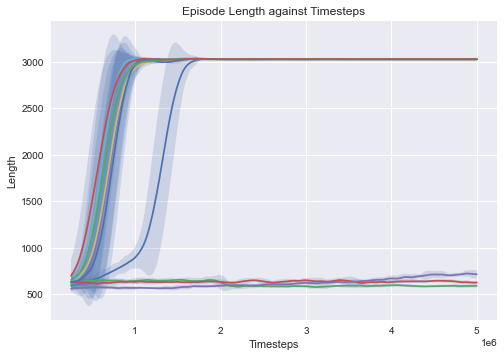

No handles with labels found to put in legend.


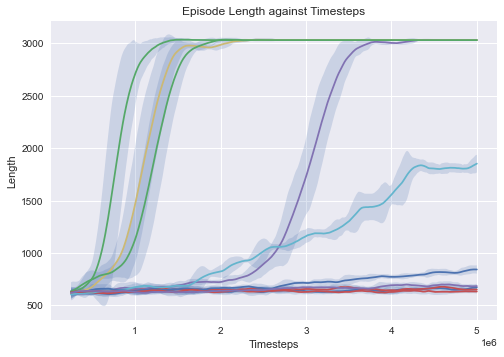

No handles with labels found to put in legend.


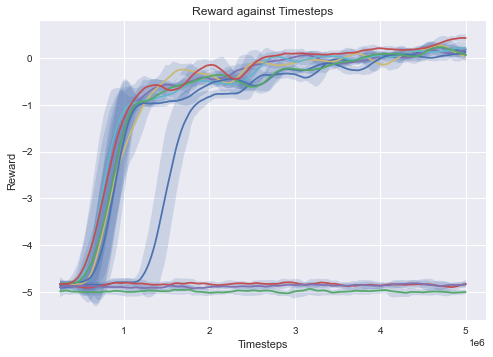

No handles with labels found to put in legend.


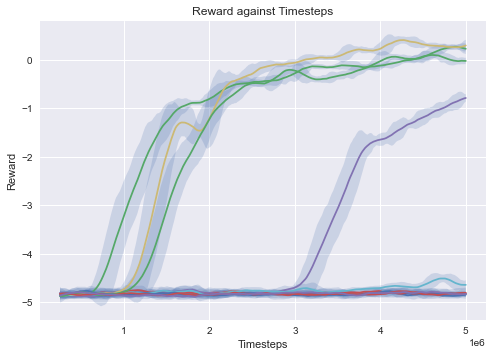

In [3]:
list_df_ppo_dnn_expert = [read_progress(f'ppo-dnn-mujoco/{i}', 'expert') for i in range(1, 11)]
list_df_ppo_bnn_expert = [read_progress(f'ppo-bnn-mujoco/{i}', 'expert') for i in range(1, 11)]

compare_eplen(list_df_ppo_dnn_expert, None)
compare_eplen(list_df_ppo_bnn_expert, None)

compare_eprew(list_df_ppo_dnn_expert, None)
compare_eprew(list_df_ppo_bnn_expert, None)

# Expert: PPO

## 3. Training Stability

In [44]:
get_rew_var(list_df_ppo_dnn_expert[0], list_df_ppo_bnn_expert[1], 'PPO-DNN', 'PPO-BNN', last_n=100_000)

Reward Variance of Last 100K: PPO-DNN=3.996, PPO-BNN=2.862


# Expert: PPO

## 4. Uncertainty

When ball is near to the net, entropy of PPO-DNN=0.774, PPO-BNN=0.416


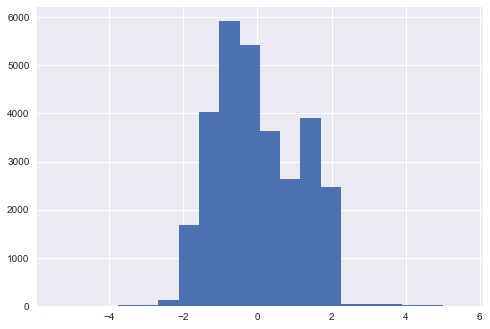

When velocity exceeds 99th percentile, entropy of PPO-DNN=0.623, PPO-BNN=0.446


In [45]:
import gym
import slimevolleygym

env = gym.make("SlimeVolley-v0")
ppo_dnn_bnn_dataset_expert = get_datasets(env, ppo_dnn_expert, ppo_bnn_expert, trials=100)
ppo_dnn_bnn_dataset_expert.to_csv("ppo_dnn_bnn_dataset_expert.csv", index=False)

get_entropy_near_net(ppo_dnn_bnn_dataset_expert, 'PPO-DNN', 'PPO-BNN')
get_entropy_high_velocity(ppo_dnn_bnn_dataset_self, 'PPO-DNN', 'PPO-BNN')

# Expert: PPO

## 5. Generalisability

In [31]:
dnn_score, bnn_score, dnn_var, bnn_var = evaluate(ppo_dnn_expert, ppo_bnn_expert, n=100)

C:\Users\notes\AppData\Roaming\Python\Python37\site-packages\gym\logger.py:30: UserWarning: WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))
100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [09:02<00:00,  5.43s/it]

Player 1: -0.14 +- 0.762
Player 2: 0.14 +- 0.762


# Expert: PPO

## 6. Agent Behaviour

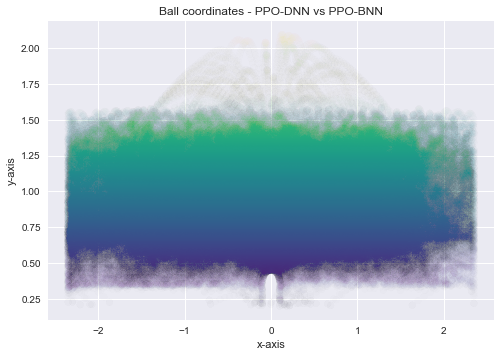

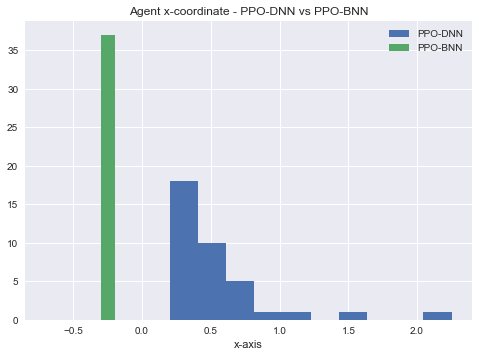

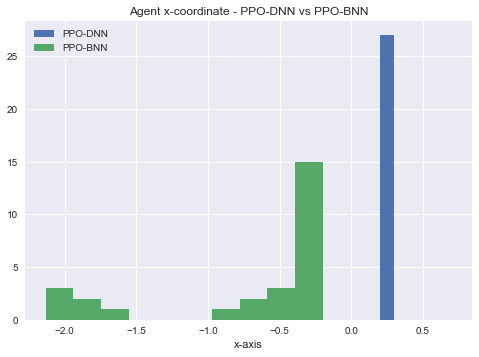

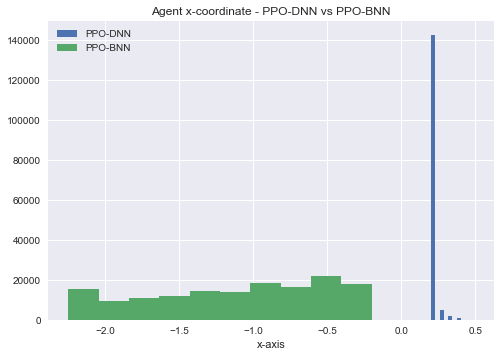

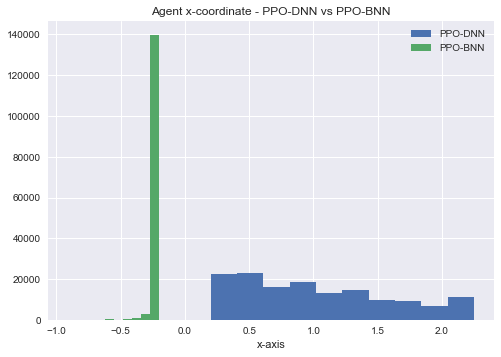

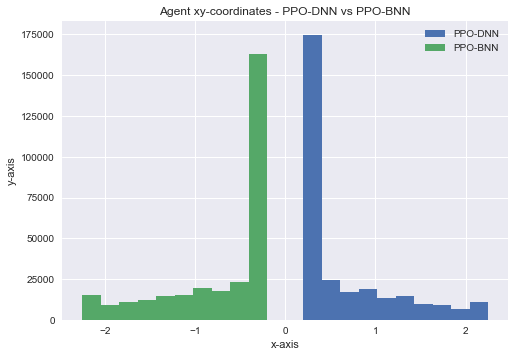

In [48]:
plot_ball_coordinates(ppo_dnn_bnn_dataset_expert, "PPO-DNN", "PPO-BNN", alpha=0.007)

plot_agent_coordinates(ppo_dnn_bnn_dataset_expert, 'PPO-DNN', 'PPO-BNN', win='left', bins=10)
plot_agent_coordinates(ppo_dnn_bnn_dataset_expert, 'PPO-DNN', 'PPO-BNN', win='right', bins=10)

plot_agent_coordinates(ppo_dnn_bnn_dataset_expert, 'PPO-DNN', 'PPO-BNN', ball='left', bins=10)
plot_agent_coordinates(ppo_dnn_bnn_dataset_expert, 'PPO-DNN', 'PPO-BNN', ball='right', bins=10)

plot_agent_coordinates(ppo_dnn_bnn_dataset_expert, 'PPO-DNN', 'PPO-BNN', alpha=0.007, bins=10)

# Self: PPO

## 1. Performance

In [49]:
ppo_dnn_self = PPO1.load(os.path.join("exp/self/ppo-dnn-mujoco", "final_model"))
ppo_bnn_self = PPO1.load(os.path.join("exp/self/ppo-bnn-mujoco", "final_model"))

# Evaluate DNN-M vs BNN-M  & BNN-M vs DNN-M
_, _, _, _ = evaluate(ppo_dnn_self, ppo_bnn_self, n=100)  # DNN: 0.038 +- 0.577, 0.073+-0.598

Loading a model without an environment, this model cannot be trained until it has a valid environment.
Loading a model without an environment, this model cannot be trained until it has a valid environment.


C:\Users\notes\AppData\Roaming\Python\Python37\site-packages\gym\logger.py:30: UserWarning: WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))
100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [08:39<00:00,  5.19s/it]

Player 1: 0.07 +- 0.778
Player 2: -0.07 +- 0.778


# Self: PPO

## 2. Sample Efficiency

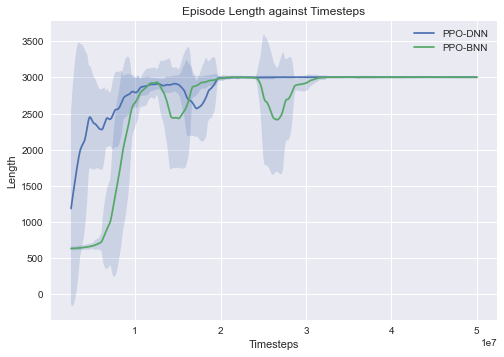

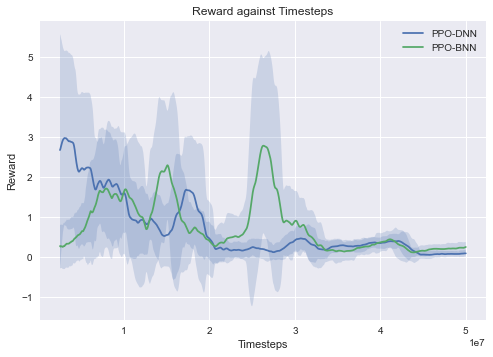

In [57]:
df_ppo_dnn_self = read_progress('ppo-dnn-mujoco', 'self')
df_ppo_bnn_self = read_progress('ppo-bnn-mujoco', 'self')

compare_eplen([df_ppo_dnn_self, df_ppo_bnn_self], ['PPO-DNN', 'PPO-BNN'])
compare_eprew([df_ppo_dnn_self, df_ppo_bnn_self], ['PPO-DNN', 'PPO-BNN'])

# Self: PPO
## 3. Training Stability

In [65]:
get_rew_var(df_ppo_dnn_self, df_ppo_bnn_self, 'PPO-DNN', 'PPO-BNN', last_n=100_000)

Reward Variance of Last 100K: PPO-DNN=0.848, PPO-BNN=0.728


# Self: PPO

## 4. Uncertainty

100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [14:40<00:00,  8.81s/it]


When ball is near to the net, entropy of PPO-DNN=0.555, PPO-BNN=0.444


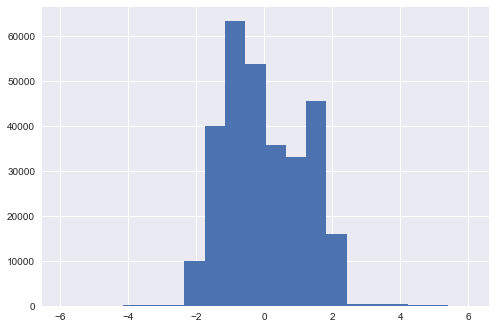

When velocity exceeds 99th percentile, entropy of PPO-DNN=0.605, PPO-BNN=0.465


In [51]:
env = gym.make("SlimeVolley-v0")

ppo_dnn_bnn_dataset_self = get_datasets(env, ppo_dnn_self, ppo_bnn_self, trials=100)
ppo_dnn_bnn_dataset_self.to_csv("ppo_dnn_bnn_dataset_self_mujoco.csv", index=False)

get_entropy_near_net(ppo_dnn_bnn_dataset_self, 'PPO-DNN', 'PPO-BNN')
get_entropy_high_velocity(ppo_dnn_bnn_dataset_self, 'PPO-DNN', 'PPO-BNN')

# Self: PPO

## 5. Generalisability

In [26]:
# PPO-DNN-Self
evaluate_single(ppo_dnn_self, n=100)  # 0.32 +- 0.691
evaluate(ppo_dnn_self, ppo_bnn_self, n=100)  # 0.09 +- 0.634
evaluate(ppo_dnn_self, ppo_dnn_expert, n=100)  # 3.47 +- 1.330

  0%|                                                                                          | 0/100 [00:00<?, ?it/s]

Player 1: 0.32 +- 0.691


  0%|                                                                                          | 0/100 [00:00<?, ?it/s]

Player 1: 0.09 +- 0.634
Player 2: -0.09 +- 0.634


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [05:48<00:00,  3.48s/it]

Player 1: 3.47 +- 1.330
Player 2: -3.47 +- 1.330


(3.47, -3.47, 1.3300751858447704, 1.3300751858447704)

In [41]:
evaluate(ppo_dnn_self, ppo_bnn_expert, n=100)

100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [09:17<00:00,  5.58s/it]

Player 1: 4.5 +- 0.866
Player 2: -4.5 +- 0.866


(4.5, -4.5, 0.8660254037844386, 0.8660254037844386)

In [42]:
# PPO-BNN-Self
evaluate_single(ppo_bnn_self, n=100)  # 0.2 +- 0.648
evaluate(ppo_bnn_self, ppo_dnn_self, n=100)  # 
evaluate(ppo_bnn_self, ppo_bnn_expert, n=100)


  0%|                                                                                          | 0/100 [00:00<?, ?it/s]

Player 1: 0.38 +- 0.903


  0%|                                                                                          | 0/100 [00:00<?, ?it/s]

Player 1: 0.0 +- 0.583
Player 2: 0.0 +- 0.583


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [07:59<00:00,  4.79s/it]

Player 1: 4.71 +- 0.668
Player 2: -4.71 +- 0.668


(4.71, -4.71, 0.6677574409918619, 0.6677574409918619)

In [43]:
evaluate(ppo_bnn_self, ppo_bnn_expert, n=100)

100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [08:04<00:00,  4.84s/it]

Player 1: 4.65 +- 0.740
Player 2: -4.65 +- 0.740


(4.65, -4.65, 0.7399324293474372, 0.7399324293474372)

# Self: PPO

## 6. Agent Behaviour

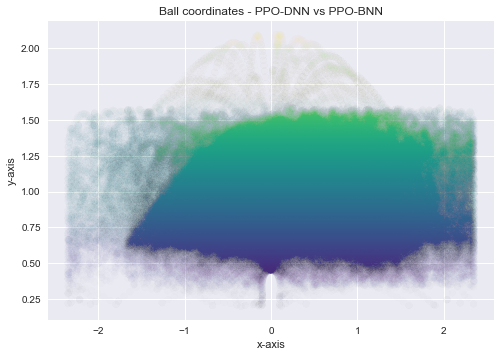

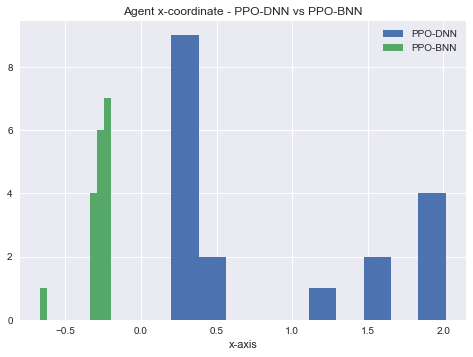

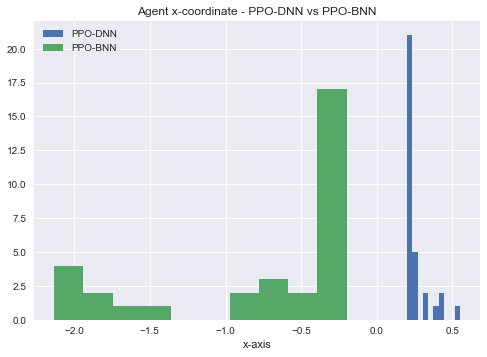

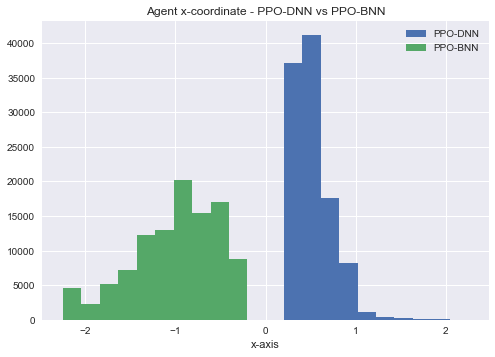

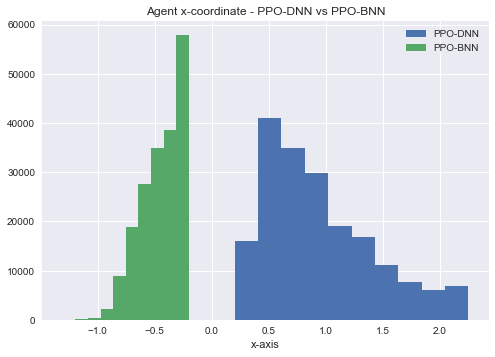

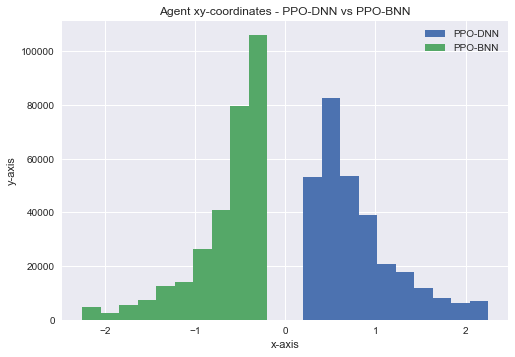

In [66]:
plot_ball_coordinates(ppo_dnn_bnn_dataset_self, "PPO-DNN", "PPO-BNN", alpha=0.007)

plot_agent_coordinates(ppo_dnn_bnn_dataset_self, 'PPO-DNN', 'PPO-BNN', win='left', bins=10)
plot_agent_coordinates(ppo_dnn_bnn_dataset_self, 'PPO-DNN', 'PPO-BNN', win='right', bins=10)

plot_agent_coordinates(ppo_dnn_bnn_dataset_self, 'PPO-DNN', 'PPO-BNN', ball='left', bins=10)
plot_agent_coordinates(ppo_dnn_bnn_dataset_self, 'PPO-DNN', 'PPO-BNN', ball='right', bins=10)

plot_agent_coordinates(ppo_dnn_bnn_dataset_self, 'PPO-DNN', 'PPO-BNN', alpha=0.007, bins=10)

In [31]:
record_game("self",  # filename
            ppo_bnn_self_mujoco, "ppo_bnn_self_mujoco",
            n=5)

Saving to: videos/self - ppo_bnn_self_mujoco vs expert.mp4
Player 1 score: 0
Player 1 score: 3
Player 1 score: 1
Player 1 score: 1
Player 1 score: -1


In [32]:
record_game("self",  # filename
            ppo_bnn_self_mujoco, "ppo_dnn_self_mujoco",
            n=5)

Saving to: videos/self - ppo_dnn_self_mujoco vs expert.mp4
Player 1 score: 1
Player 1 score: 0
Player 1 score: 2
Player 1 score: 0
Player 1 score: 1


In [33]:
record_game("self",  # filename
            ppo_dnn_self_mujoco, "ppo_dnn_self_mujoco",
            ppo_bnn_self_mujoco, "ppo_bnn_self_mujoco",
            n=5)

Saving to: videos/self - ppo_dnn_self_mujoco vs ppo_bnn_self_mujoco.mp4
Player 1 score: 0
Player 1 score: 0
Player 1 score: 0
Player 1 score: 0
Player 1 score: 0


In [ ]:
import imageio

num_episodes = 1
video_filename = 'ppo-dnn-self-mujoco.mp4'

with imageio.get_writer(video_filename, fps=60) as video:
    for _ in range(num_episodes):
        obs = env.reset()
        done = False
        total_reward = 0
        video.append_data(env.render('rgb_array'))
        
        while not done:
            action, _ = model.predict(obs)
            obs, reward, done, info = env.step(action)
            total_reward += reward
            video.append_data(env.render('rgb_array'))
        
        print("score:", total_reward)

embed_mp4(video_filename)

# Multi: PPO

## 1. Performance

In [53]:
ppo_dnn_multi = PPO1.load(os.path.join("exp/multi/ppo-dnn-mujoco", "final_model"))
ppo_bnn_multi = PPO1.load(os.path.join("exp/multi/ppo-bnn-mujoco", "final_model"))

_, _, _, _ = evaluate(ppo_dnn_multi, ppo_bnn_multi, n=100)

Loading a model without an environment, this model cannot be trained until it has a valid environment.
Loading a model without an environment, this model cannot be trained until it has a valid environment.


C:\Users\notes\AppData\Roaming\Python\Python37\site-packages\gym\logger.py:30: UserWarning: WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))
100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [08:57<00:00,  5.37s/it]

Player 1: 0.11 +- 0.871
Player 2: -0.11 +- 0.871


# Multi: PPO

## 2. Sample Efficiency

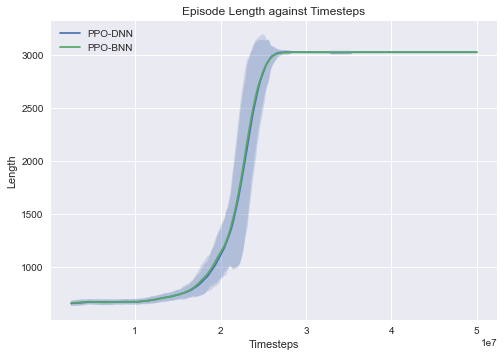

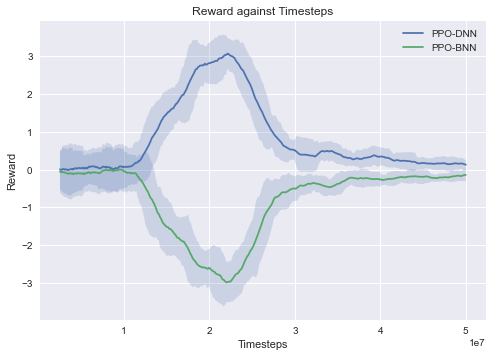

In [58]:
df_ppo_dnn_multi = read_progress('ppo-dnn-mujoco', 'multi')
df_ppo_bnn_multi = read_progress('ppo-bnn-mujoco', 'multi')

compare_eplen([df_ppo_dnn_multi, df_ppo_bnn_multi], ['PPO-DNN', 'PPO-BNN'])
compare_eprew([df_ppo_dnn_multi, df_ppo_bnn_multi], ['PPO-DNN', 'PPO-BNN'])

# Multi: PPO

## 3. Training Stability

In [61]:
get_rew_var(df_ppo_dnn_multi, df_ppo_bnn_multi, 'PPO-DNN', 'PPO-BNN', last_n=100_000)

Reward Variance of Last 100K: PPO-DNN=0.965, PPO-BNN=0.895


# Multi: PPO

## 4. Uncertainty

C:\Users\notes\AppData\Roaming\Python\Python37\site-packages\gym\logger.py:30: UserWarning: WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))
100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [14:42<00:00,  8.83s/it]


When ball is near to the net, entropy of PPO-DNN=0.508, PPO-BNN=0.727


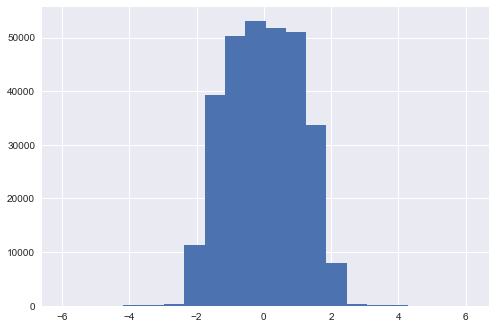

When velocity exceeds 99th percentile, entropy of PPO-DNN=0.605, PPO-BNN=0.667


In [60]:
env = gym.make("SlimeVolley-v0")

ppo_dnn_bnn_dataset_multi = get_datasets(env, ppo_dnn_multi, ppo_bnn_multi, trials=100)
ppo_dnn_bnn_dataset_multi.to_csv("ppo_dnn_bnn_dataset_multi_mujoco.csv", index=False)

get_entropy_near_net(ppo_dnn_bnn_dataset_multi, 'PPO-DNN', 'PPO-BNN')
get_entropy_high_velocity(ppo_dnn_bnn_dataset_multi, 'PPO-DNN', 'PPO-BNN')

# Multi: PPO

## 5. Generalisability

In [63]:
# PPO-DNN-Multi
evaluate_single(ppo_dnn_multi, n=100)

100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [03:08<00:00,  1.88s/it]

Player 1: 0.25 +- 0.931


(0.25, 0.931396800509858)

In [24]:
evaluate(ppo_dnn_multi, ppo_dnn_expert, n=100)

evaluate(ppo_dnn_multi, ppo_dnn_self, n=100)
evaluate(ppo_dnn_multi, ppo_bnn_self, n=100)

  0%|                                                                                          | 0/100 [00:00<?, ?it/s]

Player 1: 0.07 +- 0.941


  0%|                                                                                          | 0/100 [00:00<?, ?it/s]

Player 1: 1.19 +- 1.317
Player 2: -1.19 +- 1.317


  0%|                                                                                          | 0/100 [00:00<?, ?it/s]

Player 1: -0.34 +- 0.738
Player 2: 0.34 +- 0.738


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [08:23<00:00,  5.03s/it]

Player 1: -0.28 +- 0.849
Player 2: 0.28 +- 0.849


(-0.28, 0.28, 0.8494704232638121, 0.8494704232638121)

In [36]:
evaluate(ppo_dnn_multi, ppo_bnn_expert, n=100)

C:\Users\notes\AppData\Roaming\Python\Python37\site-packages\gym\logger.py:30: UserWarning: WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))
100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [09:30<00:00,  5.71s/it]

Player 1: 2.03 +- 1.500
Player 2: -2.03 +- 1.500


(2.03, -2.03, 1.4996999699939983, 1.4996999699939983)

In [62]:
# PPO-BNN-Multi
evaluate_single(ppo_bnn_multi, n=100)

C:\Users\notes\AppData\Roaming\Python\Python37\site-packages\gym\logger.py:30: UserWarning: WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))
100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [06:21<00:00,  3.81s/it]

Player 1: -0.09 +- 1.059


(-0.09, 1.059197809665409)

In [25]:
evaluate(ppo_bnn_multi, ppo_dnn_expert, n=100)

evaluate(ppo_bnn_multi, ppo_dnn_self, n=100)

  0%|                                                                                          | 0/100 [00:00<?, ?it/s]

Player 1: 0.04 +- 0.926


  0%|                                                                                          | 0/100 [00:00<?, ?it/s]

Player 1: 2.45 +- 1.564
Player 2: -2.45 +- 1.564


  0%|                                                                                          | 0/100 [00:00<?, ?it/s]

Player 1: -0.23 +- 0.811
Player 2: 0.23 +- 0.811


100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [12:06<00:00,  7.26s/it]

Player 1: -0.5 +- 0.964
Player 2: 0.5 +- 0.964


(-0.5, 0.5, 0.9643650760992956, 0.9643650760992956)

In [38]:
evaluate(ppo_bnn_multi, ppo_bnn_self, n=100)

100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [16:15<00:00,  9.75s/it]

Player 1: -0.57 +- 0.951
Player 2: 0.57 +- 0.951


(-0.57, 0.57, 0.9513674369033238, 0.9513674369033238)

In [37]:
evaluate(ppo_bnn_multi, ppo_bnn_expert, n=100)

100%|████████████████████████████████████████████████████████████████████████████████| 100/100 [14:18<00:00,  8.58s/it]

Player 1: 3.96 +- 1.303
Player 2: -3.96 +- 1.303


(3.96, -3.96, 1.303226764611593, 1.303226764611593)

# Multi: PPO

## 6. Agent Behaviour

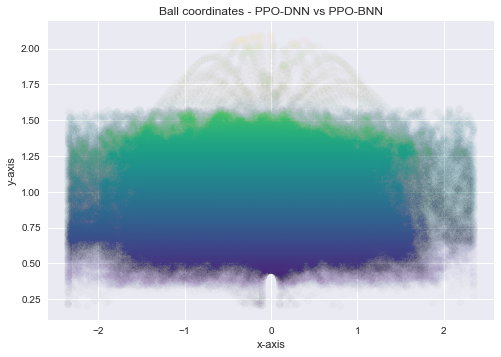

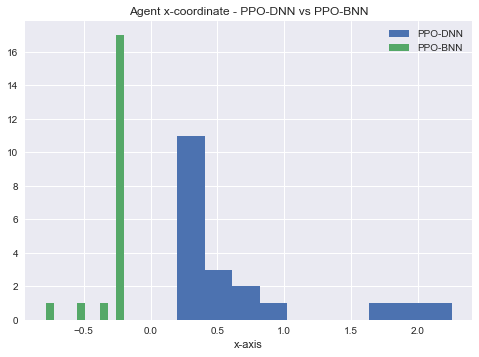

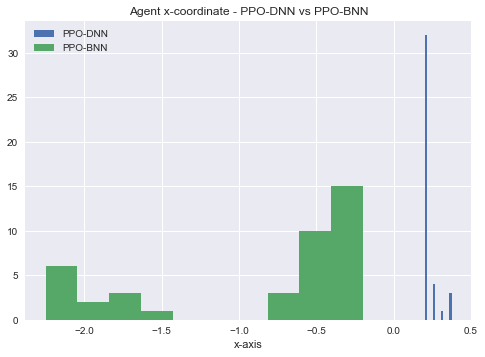

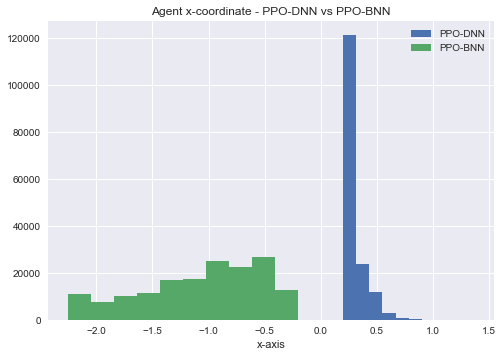

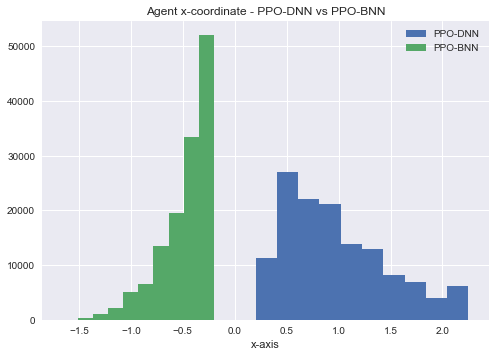

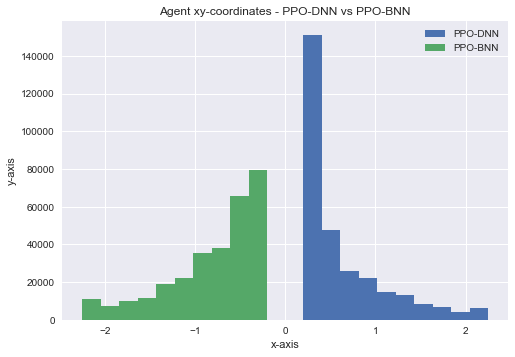

In [64]:
plot_ball_coordinates(ppo_dnn_bnn_dataset_multi, "PPO-DNN", "PPO-BNN", alpha=0.007)

plot_agent_coordinates(ppo_dnn_bnn_dataset_multi, 'PPO-DNN', 'PPO-BNN', win='left', bins=10)
plot_agent_coordinates(ppo_dnn_bnn_dataset_multi, 'PPO-DNN', 'PPO-BNN', win='right', bins=10)

plot_agent_coordinates(ppo_dnn_bnn_dataset_multi, 'PPO-DNN', 'PPO-BNN', ball='left', bins=10)
plot_agent_coordinates(ppo_dnn_bnn_dataset_multi, 'PPO-DNN', 'PPO-BNN', ball='right', bins=10)

plot_agent_coordinates(ppo_dnn_bnn_dataset_multi, 'PPO-DNN', 'PPO-BNN', alpha=0.007, bins=10)

In [70]:
env = gym.make("SlimeVolley-v0")
ppo_dnn_dnn_dataset_multi_self = get_datasets(env, ppo_dnn_multi, ppo_dnn_self, trials=30)
ppo_dnn_dnn_dataset_multi_self.to_csv("ppo_dnn_dnn_dataset_multi_self_mujoco.csv", index=False)

C:\Users\notes\AppData\Roaming\Python\Python37\site-packages\gym\logger.py:30: UserWarning: WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))
100%|██████████████████████████████████████████████████████████████████████████████████| 30/30 [02:39<00:00,  5.33s/it]


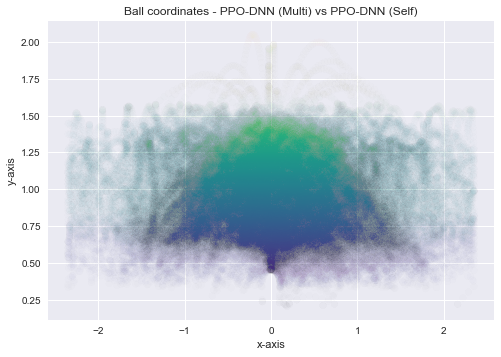

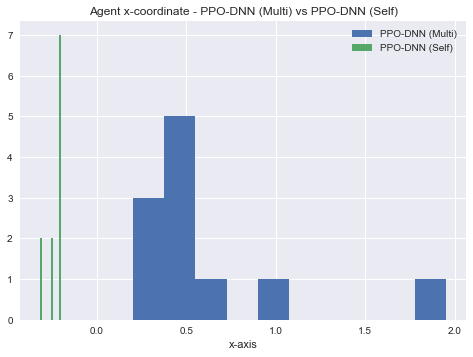

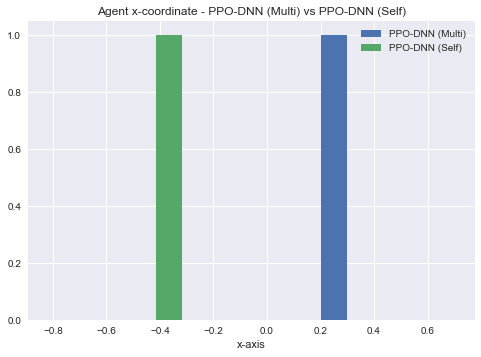

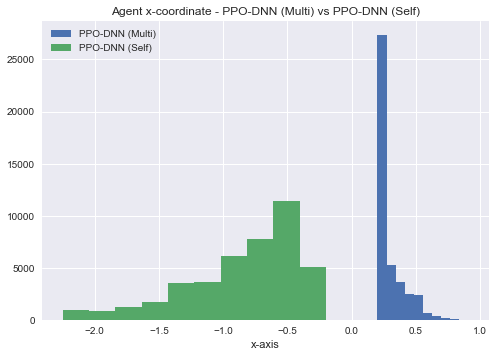

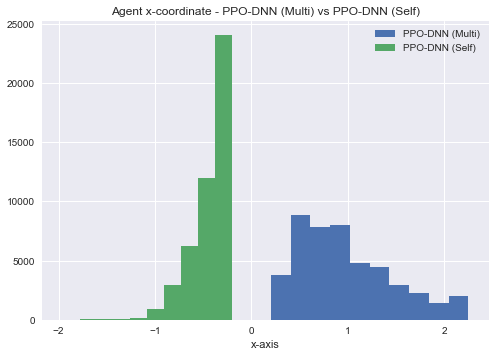

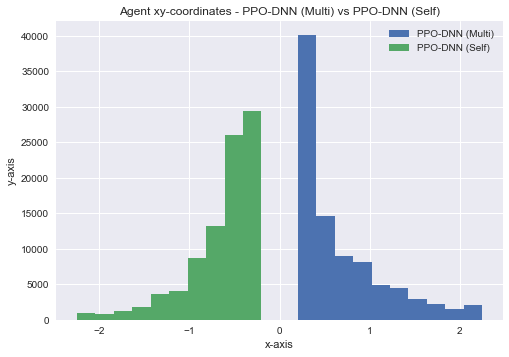

In [71]:
plot_ball_coordinates(ppo_dnn_dnn_dataset_multi_self, "PPO-DNN (Multi)", "PPO-DNN (Self)", alpha=0.007)

plot_agent_coordinates(ppo_dnn_dnn_dataset_multi_self, 'PPO-DNN (Multi)', 'PPO-DNN (Self)', win='left', bins=10)
plot_agent_coordinates(ppo_dnn_dnn_dataset_multi_self, 'PPO-DNN (Multi)', 'PPO-DNN (Self)', win='right', bins=10)

plot_agent_coordinates(ppo_dnn_dnn_dataset_multi_self, 'PPO-DNN (Multi)', 'PPO-DNN (Self)', ball='left', bins=10)
plot_agent_coordinates(ppo_dnn_dnn_dataset_multi_self, 'PPO-DNN (Multi)', 'PPO-DNN (Self)', ball='right', bins=10)

plot_agent_coordinates(ppo_dnn_dnn_dataset_multi_self, 'PPO-DNN (Multi)', 'PPO-DNN (Self)', alpha=0.007, bins=10)

In [72]:
env = gym.make("SlimeVolley-v0")
ppo_bnn_bnn_dataset_multi_self = get_datasets(env, ppo_bnn_multi, ppo_bnn_self, trials=30)
ppo_bnn_bnn_dataset_multi_self.to_csv("ppo_bnn_bnn_dataset_multi_self_mujoco.csv", index=False)

C:\Users\notes\AppData\Roaming\Python\Python37\site-packages\gym\logger.py:30: UserWarning: WARN: gym.spaces.Box autodetected dtype as <class 'numpy.float32'>. Please provide explicit dtype.
  warnings.warn(colorize('%s: %s'%('WARN', msg % args), 'yellow'))
100%|██████████████████████████████████████████████████████████████████████████████████| 30/30 [06:05<00:00, 12.18s/it]


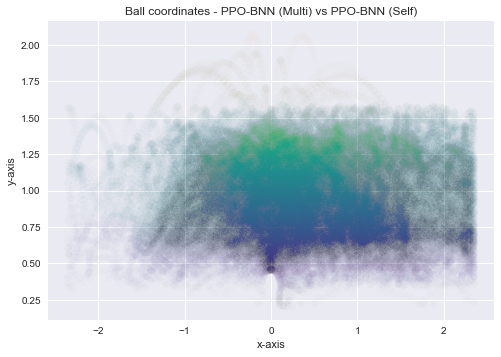

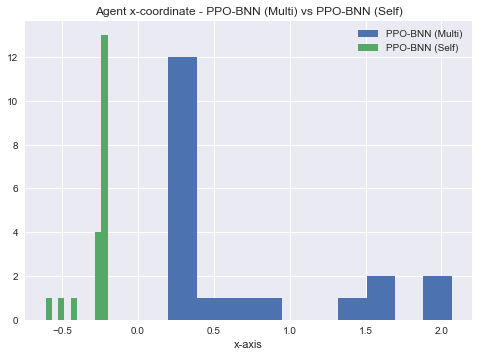

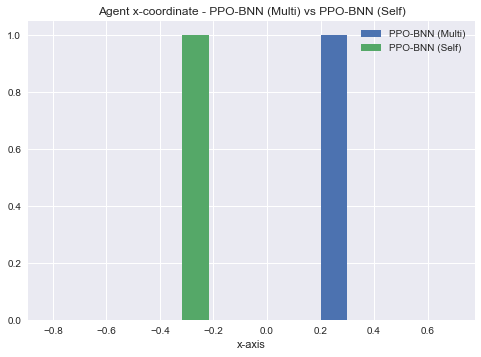

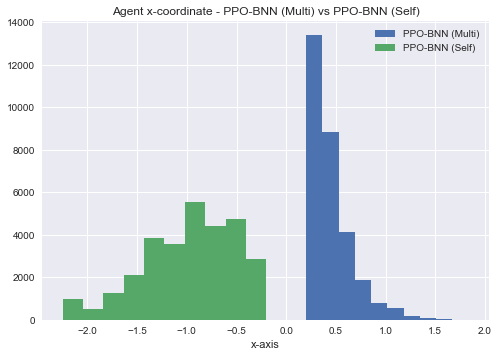

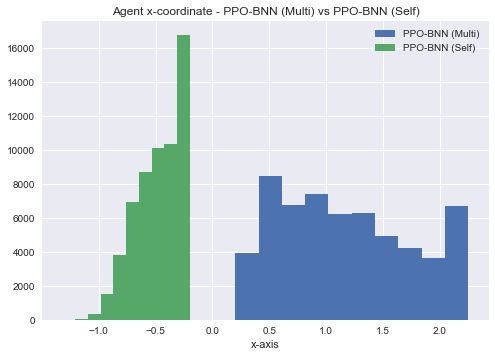

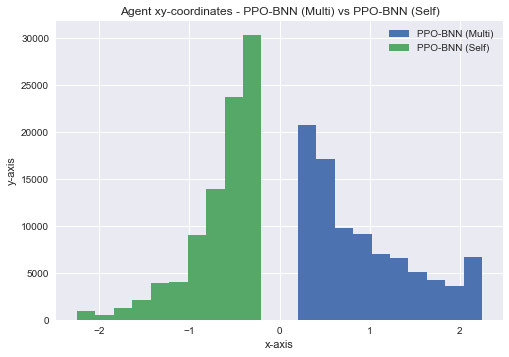

In [73]:
plot_ball_coordinates(ppo_bnn_bnn_dataset_multi_self, "PPO-BNN (Multi)", "PPO-BNN (Self)", alpha=0.007)

plot_agent_coordinates(ppo_bnn_bnn_dataset_multi_self, 'PPO-BNN (Multi)', 'PPO-BNN (Self)', win='left', bins=10)
plot_agent_coordinates(ppo_bnn_bnn_dataset_multi_self, 'PPO-BNN (Multi)', 'PPO-BNN (Self)', win='right', bins=10)

plot_agent_coordinates(ppo_bnn_bnn_dataset_multi_self, 'PPO-BNN (Multi)', 'PPO-BNN (Self)', ball='left', bins=10)
plot_agent_coordinates(ppo_bnn_bnn_dataset_multi_self, 'PPO-BNN (Multi)', 'PPO-BNN (Self)', ball='right', bins=10)

plot_agent_coordinates(ppo_bnn_bnn_dataset_multi_self, 'PPO-BNN (Multi)', 'PPO-BNN (Self)', alpha=0.007, bins=10)